### Loading Packages and Data

In [24]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
pd.set_option('display.max_rows', 8)

#import xarray as xr
import warnings
warnings.filterwarnings('ignore')
from matplotlib.backends.backend_pdf import PdfPages

from db_queries import get_outputs as go
from db_queries import get_ids
from get_draws.api import get_draws

import altair as alt
from vega_datasets import data

In [2]:
ls /mnt/team/simulation_science/pub/models/vivarium_nih_us_cvd/results/vv-variable-coverage/alabama/2023_12_15_14_36_43/count_data

binned_ldl_exposure_time.csv     risk_exposure_time.csv
binned_sbp_exposure_time.csv     sbp_medication_person_time.csv
deaths.csv                       state_person_time.csv
healthcare_visits.csv            transition_count.csv
intervention_person_time.csv     ylds.csv
ldlc_medication_person_time.csv  ylls.csv


In [3]:
sim_results_dir = '/mnt/team/simulation_science/pub/models/vivarium_nih_us_cvd/results/vv-variable-coverage/alabama/2023_12_15_14_36_43/count_data'

## Checking Stability of Risks over Time

In [4]:
state_person_time = pd.read_csv(sim_results_dir + '/state_person_time.csv')
person_time = state_person_time.loc[state_person_time['state'].isin(["acute_ischemic_stroke", "chronic_ischemic_stroke", "susceptible_to_ischemic_stroke"])].reset_index() 
person_time = person_time.rename(columns = {'value':'ptvalue'})
per_time_group = person_time.groupby(['age', 'sex', 'year','input_draw','scenario','location']).ptvalue.sum().reset_index()
per_time_group.head()

,age,sex,year,input_draw,scenario,location,ptvalue
0,25_to_29,Female,2021,29,baseline,alabama,1957.355236
1,25_to_29,Female,2021,29,baseline,california,2112.591376
2,25_to_29,Female,2021,29,baseline,florida,1824.887064
3,25_to_29,Female,2021,29,baseline,new_mexico,1847.808350
4,25_to_29,Female,2021,29,baseline,new_york,2067.438741


# SBP Medications

In [12]:
meds = pd.read_csv(sim_results_dir + '/sbp_medication_person_time.csv')
meds.head()

,Unnamed: 0,sex,year,measure,input_draw,scenario,location,age,medication_adherence,sbp_medication,value
0,0,Female,2021,sbp_medication_person_time,29,baseline,alabama,25_to_29,primary_non_adherent,no_treatment,299.126626
1,1,Female,2021,sbp_medication_person_time,29,baseline,california,25_to_29,primary_non_adherent,no_treatment,290.770705
2,2,Female,2021,sbp_medication_person_time,29,baseline,florida,25_to_29,primary_non_adherent,no_treatment,259.416838
3,3,Female,2021,sbp_medication_person_time,29,baseline,new_mexico,25_to_29,primary_non_adherent,no_treatment,281.418207
4,4,Female,2021,sbp_medication_person_time,29,baseline,new_york,25_to_29,primary_non_adherent,no_treatment,302.806297


In [13]:
meds_adherent = meds.groupby(['sex', 'year', 'input_draw', 'age', 'sbp_medication','scenario', 'location']).value.sum().reset_index()
meds_adherent_rate = meds_adherent.merge(per_time_group[['ptvalue','sex','age','year','input_draw','scenario','location']], on=['sex','age','year','input_draw','scenario','location'])
meds_adherent_rate['meds_adherent_rate'] = meds_adherent_rate['value'] / meds_adherent_rate['ptvalue']
meds_adherent_rate_summ = (meds_adherent_rate
                .groupby(['sex', 'year', 'sbp_medication','age','location'])
                .meds_adherent_rate.describe(percentiles=[.025, .975])
                .filter(['mean', '2.5%', '97.5%'])
                .reset_index())
meds_adherent_rate_summ

,sex,year,sbp_medication,age,location,mean,2.5%,97.5%
0,Female,2021,no_treatment,25_to_29,alabama,0.924285,0.913079,0.934226
1,Female,2021,no_treatment,25_to_29,california,0.913974,0.907211,0.923315
2,Female,2021,no_treatment,25_to_29,florida,0.884956,0.869652,0.895560
3,Female,2021,no_treatment,25_to_29,new_mexico,0.957489,0.952165,0.960959
...,...,...,...,...,...,...,...,...
41996,Male,2040,two_drug_std_dose_efficacy,95_plus,pennsylvania,0.023134,0.000000,0.068529
41997,Male,2040,two_drug_std_dose_efficacy,95_plus,texas,0.036955,0.000000,0.091993
41998,Male,2040,two_drug_std_dose_efficacy,95_plus,washington,0.041731,0.016158,0.076068
41999,Male,2040,two_drug_std_dose_efficacy,95_plus,west_virginia,0.033079,0.008892,0.061987


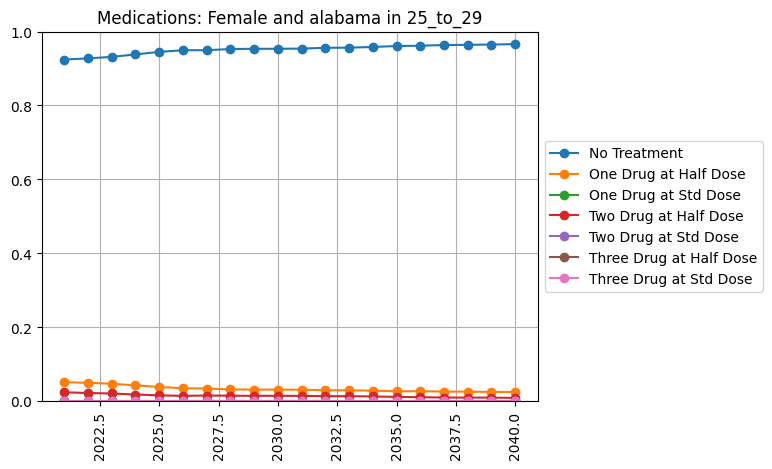

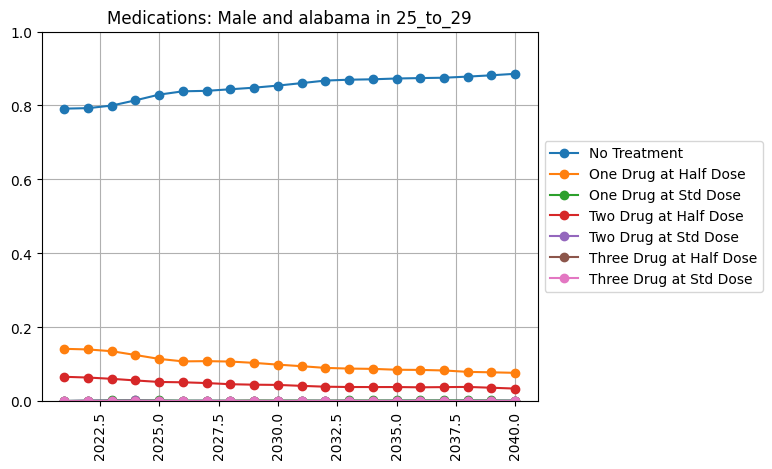

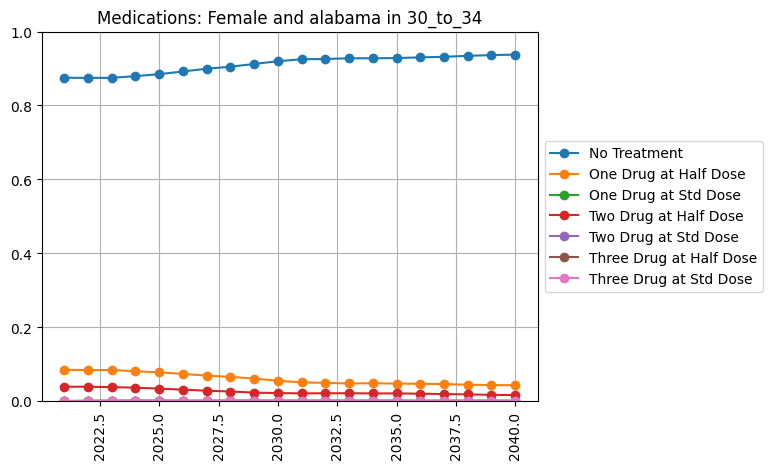

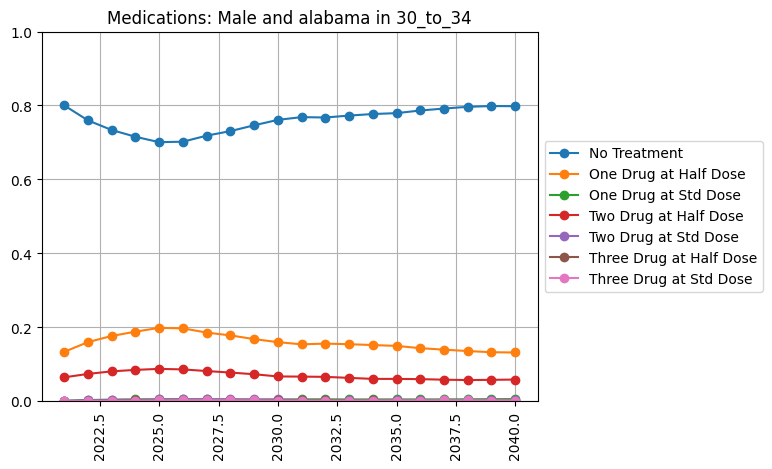

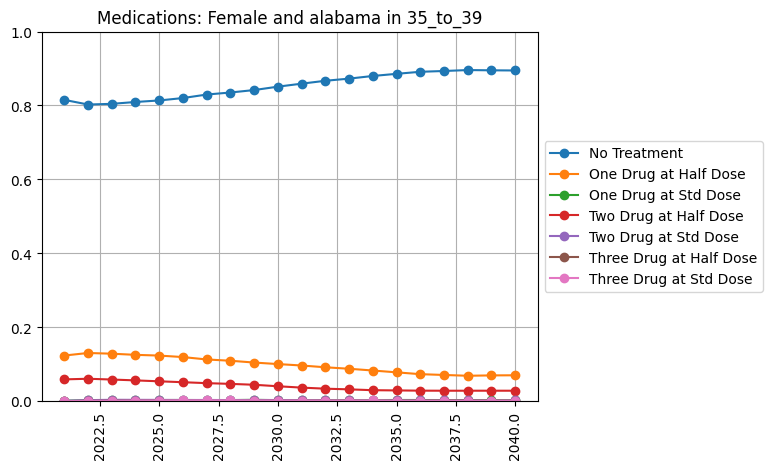

...

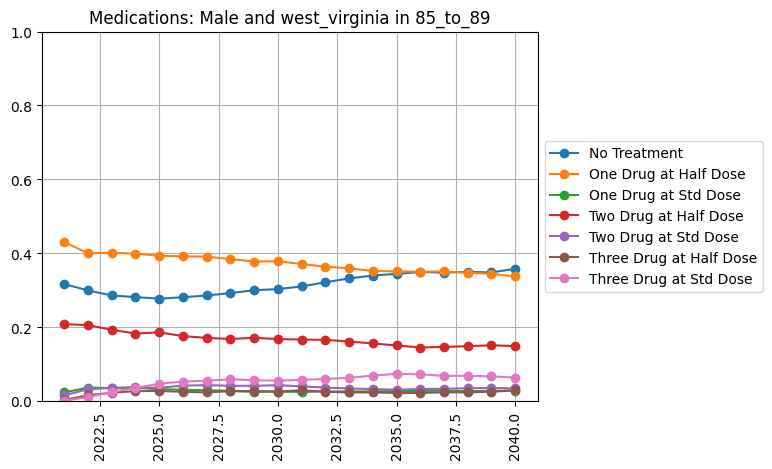

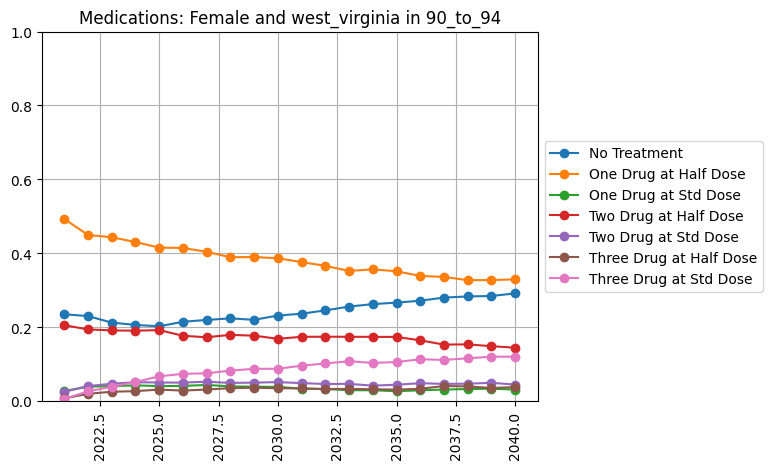

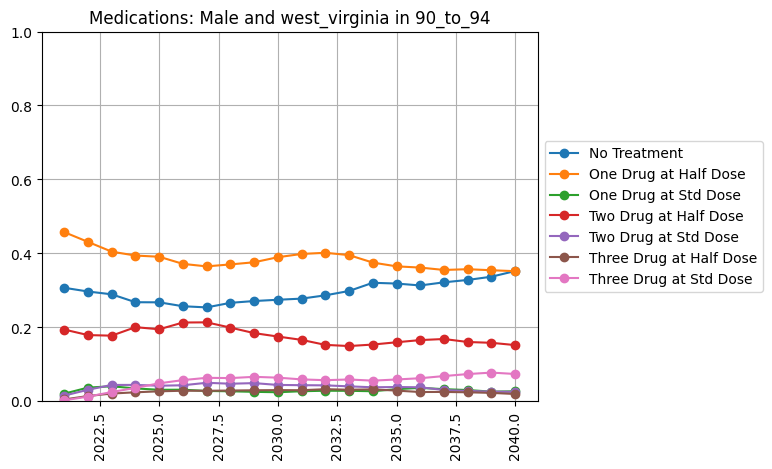

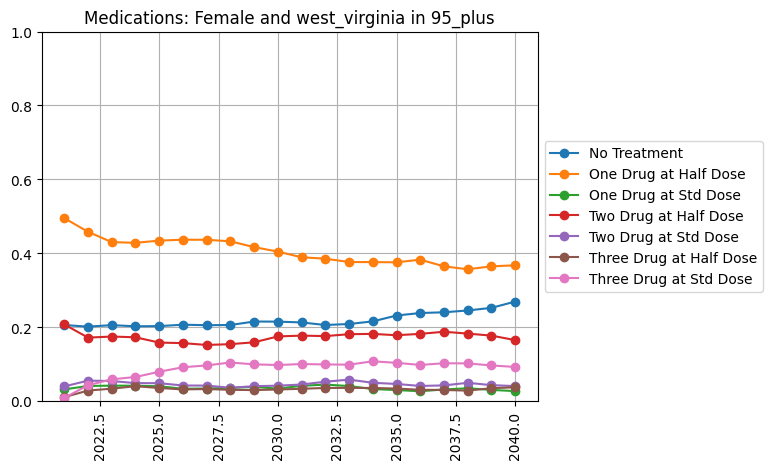

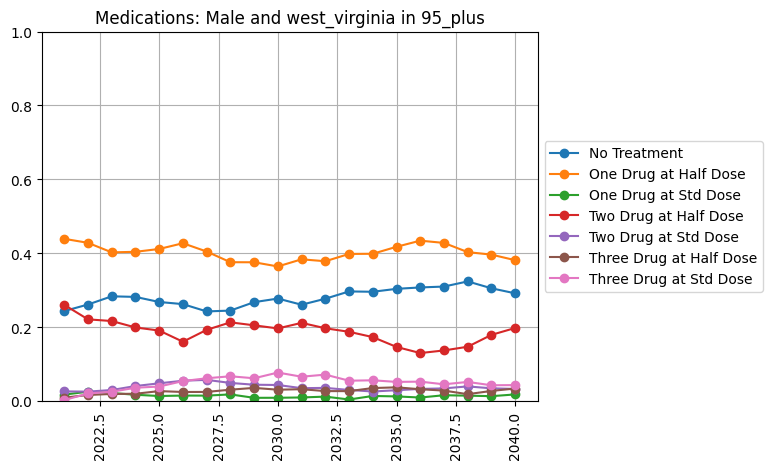

In [14]:
#%%capture
for location in meds_adherent_rate_summ.location.unique(): 
    for age in meds_adherent_rate_summ.age.unique():
        for sex in meds_adherent_rate_summ.sex.unique():
            plt.figure() 
            no_trt = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.location==location) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.sbp_medication=='no_treatment')]
            plt.plot(no_trt['year'], no_trt['mean'], marker='o')
            #plt.fill_between(no_trt['year'], no_trt['2.5%'], no_trt['97.5%'], alpha=.3)
            one_half = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.location==location) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.sbp_medication=='one_drug_half_dose_efficacy')]
            plt.plot(one_half['year'], one_half['mean'], marker='o')
            #plt.fill_between(one_half['year'], one_half['2.5%'], one_half['97.5%'], alpha=.3)
            one_std = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.location==location) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.sbp_medication=='one_drug_std_dose_efficacy')]
            plt.plot(one_std['year'], one_std['mean'], marker='o')
            #plt.fill_between(one_std['year'], one_std['2.5%'], one_std['97.5%'], alpha=.3)
            two_half = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.location==location) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.sbp_medication=='two_drug_half_dose_efficacy')]
            plt.plot(two_half['year'], two_half['mean'], marker='o')
            #plt.fill_between(two_half['year'], two_half['2.5%'], two_half['97.5%'], alpha=.3)
            two_std = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.location==location) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.sbp_medication=='two_drug_std_dose_efficacy')]
            plt.plot(two_std['year'], two_std['mean'], marker='o')
            #plt.fill_between(two_std['year'], two_std['2.5%'], two_std['97.5%'], alpha=.3)
            three_half = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.location==location) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.sbp_medication=='three_drug_half_dose_efficacy')]
            plt.plot(three_half['year'], three_half['mean'], marker='o')
            #plt.fill_between(three_half['year'], three_half['2.5%'], three_half['97.5%'], alpha=.3)
            three_std = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.location==location) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.sbp_medication=='three_drug_std_dose_efficacy')]
            plt.plot(three_std['year'], three_std['mean'], marker='o')
            #plt.fill_between(three_std['year'], three_std['2.5%'], three_std['97.5%'], alpha=.3)
            plt.title(f'Medications: {sex} and {location} in {age}') 
            plt.xticks(rotation=90)
            plt.ylim(0,1)
            plt.legend(['No Treatment', 'One Drug at Half Dose','One Drug at Std Dose','Two Drug at Half Dose','Two Drug at Std Dose','Three Drug at Half Dose','Three Drug at Std Dose'],loc='center left', bbox_to_anchor=(1, 0.5))
            plt.grid()

In [27]:
def convert(word):
    return ' '.join(x.capitalize() or '_' for x in word.split('_'))

In [31]:
maps_data_sbp = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.year == 2030) & (meds_adherent_rate_summ.sbp_medication == 'no_treatment')].reset_index()
maps_data_sbp['total_trt_rate'] = 1 - maps_data_sbp['mean']
maps_data_sbp = maps_data_sbp[['sex','age','location','total_trt_rate']]
maps_data_sbp['location'] = maps_data_sbp.location.apply(convert)
pop = data.population_engineers_hurricanes()
pop= pop.rename(columns = {'state':'location'})
maps_data_sbp = maps_data_sbp.merge(pop[['location','id']], on=['location'])
maps_data_sbp.head()

,sex,age,location,total_trt_rate,id
0,Female,25_to_29,Alabama,0.046617,1
1,Female,30_to_34,Alabama,0.080313,1
2,Female,35_to_39,Alabama,0.149122,1
3,Female,40_to_44,Alabama,0.228395,1
4,Female,45_to_49,Alabama,0.297948,1


In [44]:
def sbp_ages(data_1): 
    charts = []
    for age in data_1.age.unique(): 

        subdata = data_1.loc[(data_1.age == age) & (data_1.sex == 'Female')] 
        states = alt.topo_feature(data.us_10m.url, 'states')
        variable_list = ['total_trt_rate']

        background_1 = alt.Chart(states).mark_geoshape(
            fill='lightgray',
            stroke='white'
        ).project('albersUsa').properties(
            width=500,
            height=300
        )

        overlay_1 = alt.Chart(states).mark_geoshape().encode(
            color=alt.Color('total_trt_rate:Q', title= 'Treatment Rate'),
        ).transform_lookup(
            lookup='id',
            from_=alt.LookupData(subdata, 'id', list(subdata.columns))
        ).properties(
            width=500,
            height=300,
            title=f'SBP Treatment Rate in 2030 for Females, {age}'
        ).project(
            type='albersUsa'
        )

        chart_1 = alt.layer(background_1, overlay_1)
        
        subdata = data_1.loc[(data_1.age == age) & (data_1.sex == 'Male')] 
        states = alt.topo_feature(data.us_10m.url, 'states')
        variable_list = ['total_trt_rate']

        background_2 = alt.Chart(states).mark_geoshape(
            fill='lightgray',
            stroke='white'
        ).project('albersUsa').properties(
            width=500,
            height=300
        )

        overlay_2 = alt.Chart(states).mark_geoshape().encode(
            color=alt.Color('total_trt_rate:Q', title= 'Treatment Rate'),
        ).transform_lookup(
            lookup='id',
            from_=alt.LookupData(subdata, 'id', list(subdata.columns))
        ).properties(
            width=500,
            height=300,
            title=f'SBP Treatment Rate in 2030 for Males, {age}'
        ).project(
            type='albersUsa'
        )

        chart_2 = alt.layer(background_2, overlay_2)

        chart = alt.hconcat(chart_1, chart_2)

        charts.append(chart)
    return charts

In [45]:
sbp_charts = sbp_ages(maps_data_sbp)
alt.vconcat(*sbp_charts).resolve_scale(color="independent")

alt.VConcatChart(...)

# LDL-C Meds

In [15]:
ldl_meds = pd.read_csv(sim_results_dir + '/ldlc_medication_person_time.csv')
ldl_meds.head()

,Unnamed: 0,sex,year,measure,input_draw,scenario,location,age,medication_adherence,ldlc_medication,value
0,0,Female,2021,ldlc_medication_person_time,29,baseline,alabama,25_to_29,primary_non_adherent,high_intensity,0.0
1,1,Female,2021,ldlc_medication_person_time,29,baseline,california,25_to_29,primary_non_adherent,high_intensity,0.0
2,2,Female,2021,ldlc_medication_person_time,29,baseline,florida,25_to_29,primary_non_adherent,high_intensity,0.0
3,3,Female,2021,ldlc_medication_person_time,29,baseline,new_mexico,25_to_29,primary_non_adherent,high_intensity,0.0
4,4,Female,2021,ldlc_medication_person_time,29,baseline,new_york,25_to_29,primary_non_adherent,high_intensity,0.0


In [16]:
meds_adherent_ldl = ldl_meds.groupby(['sex', 'year', 'input_draw', 'age', 'ldlc_medication','scenario', 'location']).value.sum().reset_index()
meds_adherent_rate_ldl = meds_adherent_ldl.merge(per_time_group[['ptvalue','sex','age','year','input_draw','scenario','location']], on=['sex','age','year','input_draw','scenario','location'])
meds_adherent_rate_ldl['meds_adherent_rate'] = meds_adherent_rate_ldl['value'] / meds_adherent_rate_ldl['ptvalue']
meds_adherent_rate_summ_ldl = (meds_adherent_rate_ldl
                .groupby(['sex', 'year', 'ldlc_medication','age','location'])
                .meds_adherent_rate.describe(percentiles=[.025, .975])
                .filter(['mean', '2.5%', '97.5%'])
                .reset_index())
meds_adherent_rate_summ_ldl

,sex,year,ldlc_medication,age,location,mean,2.5%,97.5%
0,Female,2021,high_intensity,25_to_29,alabama,0.003699,0.002125,0.005870
1,Female,2021,high_intensity,25_to_29,california,0.009570,0.007195,0.011831
2,Female,2021,high_intensity,25_to_29,florida,0.012428,0.007168,0.016529
3,Female,2021,high_intensity,25_to_29,new_mexico,0.002924,0.000931,0.005334
...,...,...,...,...,...,...,...,...
35996,Male,2040,no_treatment,95_plus,pennsylvania,0.473044,0.391426,0.553306
35997,Male,2040,no_treatment,95_plus,texas,0.460159,0.323392,0.586845
35998,Male,2040,no_treatment,95_plus,washington,0.492317,0.384677,0.599983
35999,Male,2040,no_treatment,95_plus,west_virginia,0.452414,0.393806,0.556455


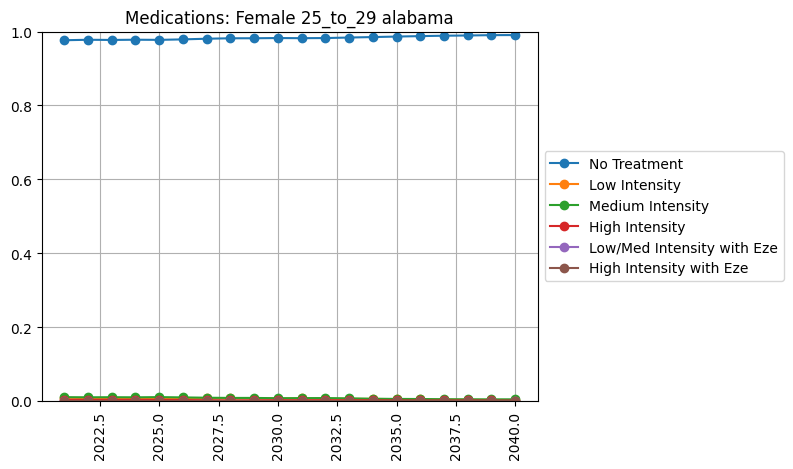

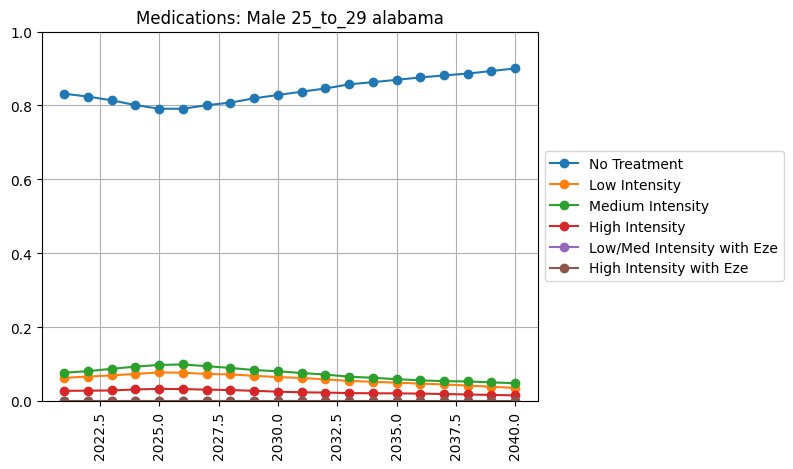

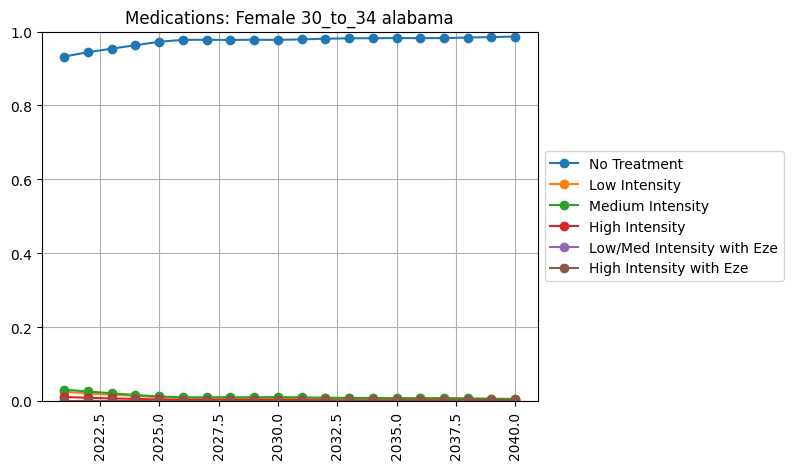

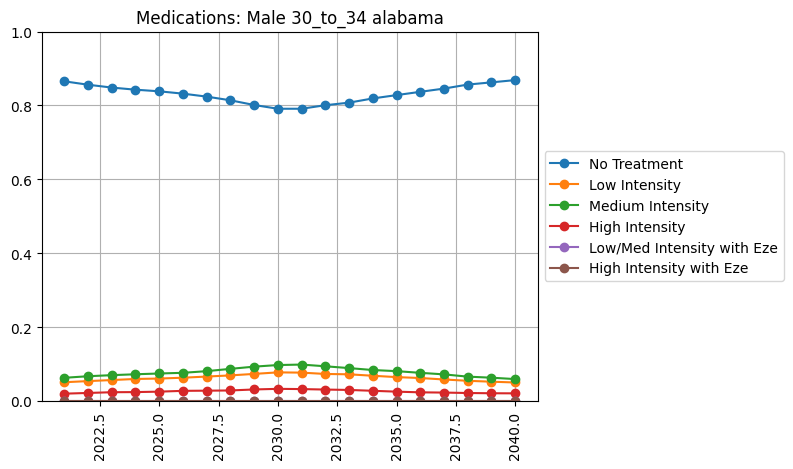

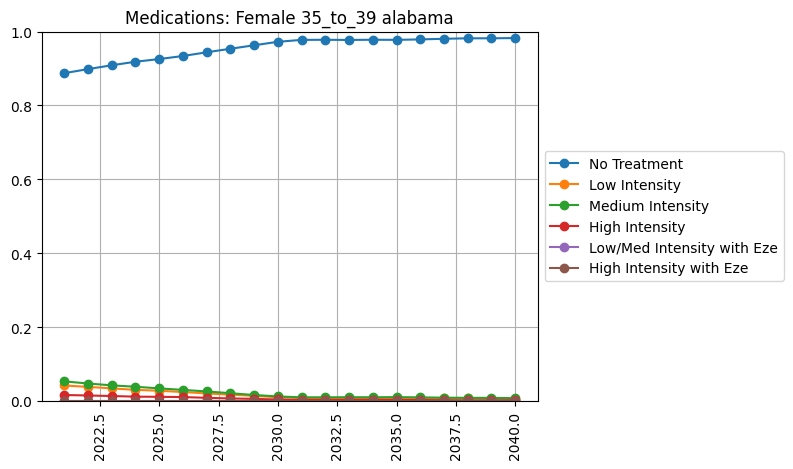

...

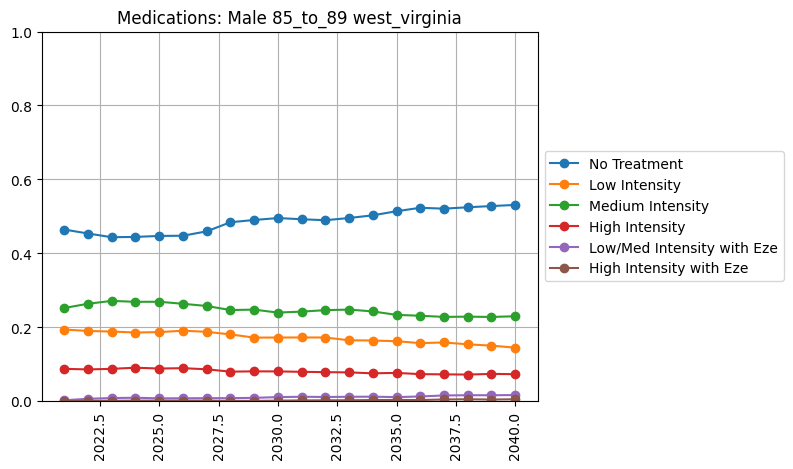

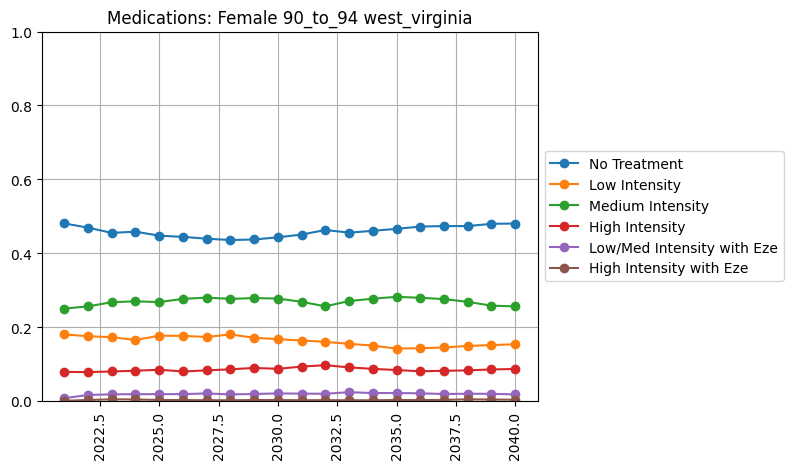

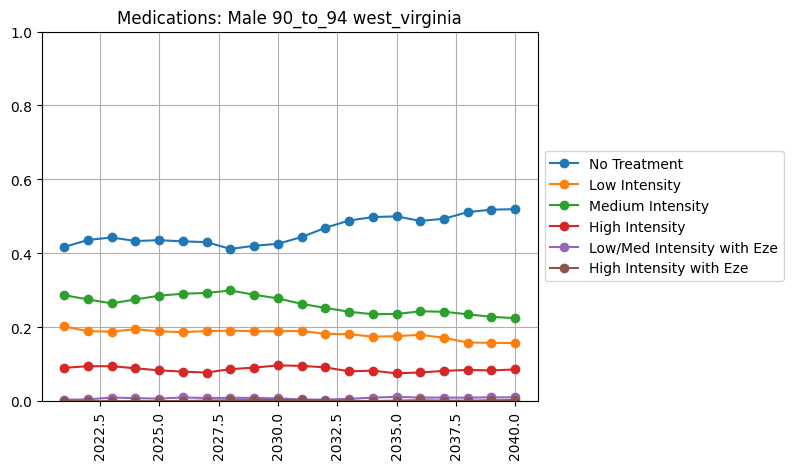

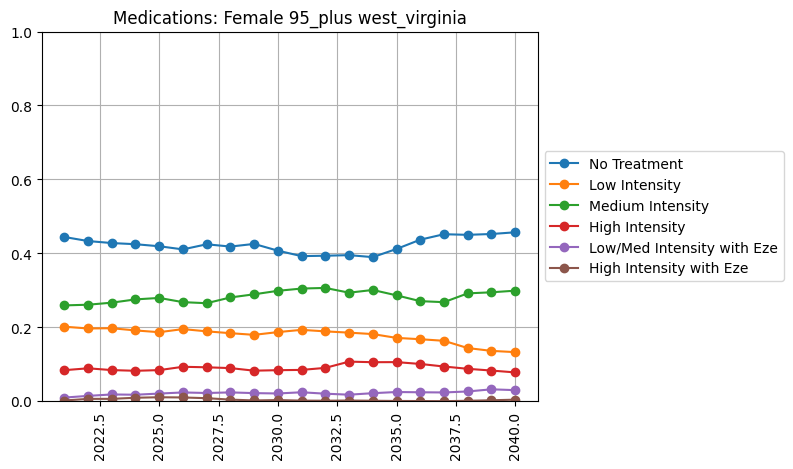

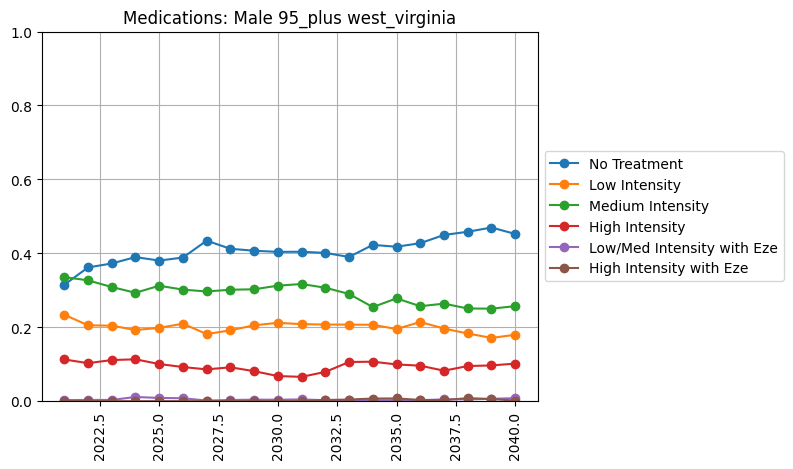

In [17]:
#%%capture
for location in meds_adherent_rate_summ_ldl.location.unique():
    for age in meds_adherent_rate_summ_ldl.age.unique():
        for sex in meds_adherent_rate_summ_ldl.sex.unique():
            plt.figure() 
            no_trt = meds_adherent_rate_summ_ldl.loc[(meds_adherent_rate_summ_ldl.location==location) & (meds_adherent_rate_summ_ldl.sex==sex) & (meds_adherent_rate_summ_ldl.age==age) & (meds_adherent_rate_summ_ldl.ldlc_medication=='no_treatment')]
            plt.plot(no_trt['year'], no_trt['mean'], marker='o')
            #plt.fill_between(no_trt['year'], no_trt['2.5%'], no_trt['97.5%'], alpha=.3)
            one_half = meds_adherent_rate_summ_ldl.loc[(meds_adherent_rate_summ_ldl.location==location) & (meds_adherent_rate_summ_ldl.sex==sex) & (meds_adherent_rate_summ_ldl.age==age) & (meds_adherent_rate_summ_ldl.ldlc_medication=='low_intensity')]
            plt.plot(one_half['year'], one_half['mean'], marker='o')
            #plt.fill_between(one_half['year'], one_half['2.5%'], one_half['97.5%'], alpha=.3)
            one_std = meds_adherent_rate_summ_ldl.loc[(meds_adherent_rate_summ_ldl.location==location) & (meds_adherent_rate_summ_ldl.sex==sex) & (meds_adherent_rate_summ_ldl.age==age) & (meds_adherent_rate_summ_ldl.ldlc_medication=='medium_intensity')]
            plt.plot(one_std['year'], one_std['mean'], marker='o')
            #plt.fill_between(one_std['year'], one_std['2.5%'], one_std['97.5%'], alpha=.3)
            two_half = meds_adherent_rate_summ_ldl.loc[(meds_adherent_rate_summ_ldl.location==location) & (meds_adherent_rate_summ_ldl.sex==sex) & (meds_adherent_rate_summ_ldl.age==age) & (meds_adherent_rate_summ_ldl.ldlc_medication=='high_intensity')]
            plt.plot(two_half['year'], two_half['mean'], marker='o')
            #plt.fill_between(two_half['year'], two_half['2.5%'], two_half['97.5%'], alpha=.3)
            two_std = meds_adherent_rate_summ_ldl.loc[(meds_adherent_rate_summ_ldl.location==location) & (meds_adherent_rate_summ_ldl.sex==sex) & (meds_adherent_rate_summ_ldl.age==age) & (meds_adherent_rate_summ_ldl.ldlc_medication=='low_med_with_eze')]
            plt.plot(two_std['year'], two_std['mean'], marker='o')
            #plt.fill_between(two_std['year'], two_std['2.5%'], two_std['97.5%'], alpha=.3)
            three_half = meds_adherent_rate_summ_ldl.loc[(meds_adherent_rate_summ_ldl.location==location) & (meds_adherent_rate_summ_ldl.sex==sex) & (meds_adherent_rate_summ_ldl.age==age) & (meds_adherent_rate_summ_ldl.ldlc_medication=='high_with_eze')]
            plt.plot(three_half['year'], three_half['mean'], marker='o')
            #plt.fill_between(three_half['year'], three_half['2.5%'], three_half['97.5%'], alpha=.3)
            plt.title(f'Medications: {sex} {age} {location}') 
            plt.xticks(rotation=90)
            plt.ylim(0,1)
            plt.legend(['No Treatment','Low Intensity','Medium Intensity','High Intensity','Low/Med Intensity with Eze','High Intensity with Eze'],loc='center left', bbox_to_anchor=(1, 0.5))
            plt.grid()

In [46]:
maps_data_ldl = meds_adherent_rate_summ_ldl.loc[(meds_adherent_rate_summ_ldl.year == 2030) & (meds_adherent_rate_summ_ldl.ldlc_medication == 'no_treatment')].reset_index()
maps_data_ldl['total_trt_rate'] = 1 - maps_data_ldl['mean']
maps_data_ldl = maps_data_ldl[['sex','age','location','total_trt_rate']]
maps_data_ldl['location'] = maps_data_ldl.location.apply(convert)
pop = data.population_engineers_hurricanes()
pop= pop.rename(columns = {'state':'location'})
maps_data_ldl = maps_data_ldl.merge(pop[['location','id']], on=['location'])
maps_data_ldl.head()

,sex,age,location,total_trt_rate,id
0,Female,25_to_29,Alabama,0.017561,1
1,Female,30_to_34,Alabama,0.022516,1
2,Female,35_to_39,Alabama,0.027746,1
3,Female,40_to_44,Alabama,0.074622,1
4,Female,45_to_49,Alabama,0.117755,1


In [49]:
def ldlc_ages(data_1): 
    charts = []
    for age in data_1.age.unique(): 

        subdata = data_1.loc[(data_1.age == age) & (data_1.sex == 'Female')] 
        states = alt.topo_feature(data.us_10m.url, 'states')
        variable_list = ['total_trt_rate']

        background_1 = alt.Chart(states).mark_geoshape(
            fill='lightgray',
            stroke='white'
        ).project('albersUsa').properties(
            width=500,
            height=300
        )

        overlay_1 = alt.Chart(states).mark_geoshape().encode(
            color=alt.Color('total_trt_rate:Q', title= 'Treatment Rate'),
        ).transform_lookup(
            lookup='id',
            from_=alt.LookupData(subdata, 'id', list(subdata.columns))
        ).properties(
            width=500,
            height=300,
            title=f'LDL-C Treatment Rate in 2030 for Females, {age}'
        ).project(
            type='albersUsa'
        )

        chart_1 = alt.layer(background_1, overlay_1)
        
        subdata = data_1.loc[(data_1.age == age) & (data_1.sex == 'Male')] 
        states = alt.topo_feature(data.us_10m.url, 'states')
        variable_list = ['total_trt_rate']

        background_2 = alt.Chart(states).mark_geoshape(
            fill='lightgray',
            stroke='white'
        ).project('albersUsa').properties(
            width=500,
            height=300
        )

        overlay_2 = alt.Chart(states).mark_geoshape().encode(
            color=alt.Color('total_trt_rate:Q', title= 'Treatment Rate'),
        ).transform_lookup(
            lookup='id',
            from_=alt.LookupData(subdata, 'id', list(subdata.columns))
        ).properties(
            width=500,
            height=300,
            title=f'LDL-C Treatment Rate in 2030 for Males, {age}'
        ).project(
            type='albersUsa'
        )

        chart_2 = alt.layer(background_2, overlay_2)

        chart = alt.hconcat(chart_1, chart_2)

        charts.append(chart)
    return charts

In [50]:
ldl_charts = ldlc_ages(maps_data_ldl)
alt.vconcat(*ldl_charts).resolve_scale(color="independent")

alt.VConcatChart(...)